In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
# download people dataset
!mkdir /content/drone_people_dataset_black/
!cp /content/drive/Shareddrives/InnLab_Carbonaro/DronePeopleDataset/drone_people_dataset_black.zip /content/
!unzip -q /content/drone_people_dataset_black.zip -d /content/drone_people_dataset_black/

In [3]:
# import dependencies
import cv2
import random as rnd
import numpy as np
import json
import os, os.path
from google.colab.patches import cv2_imshow
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.path import Path
import matplotlib.patches as patches
import io

In [4]:
# utility functions

# read image from path and resize it sideXside
def get_person(side, path):
  image = cv2.imread(path, -1)
  image = cv2.resize(image, (side, side))
  return image

# read an image, make white or black transparent, returns the image with corresponding alpha channel
def transparency(img, occ_color = None):
  img = img[:, :, :3]  # read only the rgb channels from thr image
  tmp = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  # make white transparent, else make black transparent
  if occ_color:
    _, alpha = cv2.threshold(tmp, 0, 255, cv2.THRESH_BINARY_INV)
  else:
    _, alpha = cv2.threshold(tmp, 0, 255, cv2.THRESH_BINARY)
  b, g, r = cv2.split(img)
  rgba = [b, g, r, alpha]
  dst = cv2.merge(rgba, 4)
  return dst

# create a random filled black shape with white background
def get_random_shape(height, width):
  n = 8 # Number of possibly sharp edges
  r = .7 # magnitude of the perturbation from the unit circle, 
  # should be between 0 and 1
  N = n*3+1 # number of points in the Path
  # There is the initial point and 3 points per cubic bezier curve. Thus, the curve will only pass though n points, which will be the sharp edges, the other 2 modify the shape of the bezier curve
  angles = np.linspace(0,2*np.pi,N)
  codes = np.full(N,Path.CURVE4)
  codes[0] = Path.MOVETO
  verts = np.stack((np.cos(angles),np.sin(angles))).T*(2*r*np.random.random(N)+1-r)[:,None]
  verts[-1,:] = verts[0,:] # Using this instad of Path.CLOSEPOLY avoids an innecessary straight line
  path = Path(verts, codes)
  fig = plt.figure()
  ax = fig.add_subplot(111)
  patch = patches.PathPatch(path, facecolor='none', lw=2, fill=True, color="Black")
  ax.add_patch(patch)
  ax.set_xlim(np.min(verts)*1.1, np.max(verts)*1.1)
  ax.set_ylim(np.min(verts)*1.1, np.max(verts)*1.1)
  ax.axis('off') # removes the axis to leave only the shape
  # save the image to a numpy array
  io_buf = io.BytesIO()
  fig.savefig(io_buf, format='raw')
  io_buf.seek(0)
  img_arr = np.reshape(np.frombuffer(io_buf.getvalue(), dtype=np.uint8),
                      newshape=(int(fig.bbox.bounds[3]), int(fig.bbox.bounds[2]), -1))
  plt.close()
  io_buf.close()
  # resize image
  res = cv2.resize(img_arr, dsize=(height, width), interpolation=cv2.INTER_CUBIC)
  img = np.copy(res[:, :, :3]) 
  # make every non-white pixel black
  img[np.where((img!=[255,255,255]).all(axis=2))] = [0,0,0]
  return img

# compute average brightness of image
def get_avg_brightness(image):
  return np.average(np.linalg.norm(image, axis=2)) / np.sqrt(3)

# function that increase brightness of an image given a value
def increase_brightness(img, value = 30):
  alpha = img[:, :, 3]
  hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
  h, s, v = cv2.split(hsv)
  lim = 255 - value
  v[v > lim] = 255
  for pixel in v[v <= lim]:
    pixel += value
  final_hsv = cv2.merge((h, s, v))
  img = cv2.cvtColor(final_hsv, cv2.COLOR_HSV2BGR)
  # re-assign alpha channel to image
  b, g, r = cv2.split(img)
  rgba = [b, g, r, alpha]
  dst = cv2.merge(rgba, 4)
  return dst
    
# insert patch in image to specified location
def add_patch(dst, l_img, x1, x2, y1, y2):
  alpha_s = dst[:, :, 3] / 255.0
  alpha_l = 1.0 - alpha_s
  for c in range(0, 3):
      l_img[y1:y2, x1:x2, c] = (alpha_s * dst[:, :, c] + alpha_l * l_img[y1:y2, x1:x2, c])
  return l_img

# get a random point from the background image where is possible to paste the patch image
def get_random_paste_point(bkg_shape, patch_shape):
  x_offset = rnd.randint(0, bkg_shape[1] - patch_shape[1])
  y_offset = rnd.randint(0, bkg_shape[0] - patch_shape[0])
  y1, y2 = y_offset, y_offset + patch_shape[0]
  x1, x2 = x_offset, x_offset + patch_shape[1]
  return x1, x2, y1, y2

# add people to bkg image with random occlusion
def add_people(l_img, boxes):
  # compute brightness of background
  l_br = get_avg_brightness(l_img)
  # number of images in the dataset
  n_people = rnd.randint(0, 10)
  print(f'n_people = {n_people}')
  # get n_people random indexes to choose the people images to paste
  indexes = rnd.sample(range(0, N_IMGS - 1), n_people)
  for index in indexes:
    person = get_person(BBOX_SIZE, IMG_FOLDER + os.listdir(IMG_FOLDER)[index])
    # random occlusion
    if rnd.randint(0, 1) < 0.3:
      s1, s2 = person.shape[0], person.shape[1]  # get the shape of the person image
      occ_mask = get_random_shape(int(s1/16), int(s2/16))  # get random shape of size 1/16 of the person
      occ_mask = transparency(occ_mask, 'w')  # make the white background of the shape transparent
      x1, x2, y1, y2 = get_random_paste_point(person.shape, occ_mask.shape)  
      person = add_patch(occ_mask, person, x1, x2, y1, y2) 
    person = transparency(person)  # make the black elements of the person image transparent
    s_br = get_avg_brightness(person)
    diff = int(l_br - s_br)
    dst = increase_brightness(person, diff)
    x1, x2, y1, y2 = get_random_paste_point(l_img.shape, dst.shape)
    l_img = add_patch(dst, l_img, x1, x2, y1, y2)
    boxes = np.vstack((boxes, np.array([x1, x2, y1, y2])))  # add the bbox label to the original list
  return l_img, boxes



In [6]:
IMG_FOLDER = '/content/drone_people_dataset_black/'
N_IMGS = len([name for name in os.listdir(IMG_FOLDER)])
BBOX_SIZE =  55
BKG_IMAGE = '/content/drive/Shareddrives/InnLab_Carbonaro/DronePeopleDataset/Images_videos/train_BLA_0003.JPG'

# open json file
with open('/content/drive/Shareddrives/InnLab_Carbonaro/DronePeopleDataset/prova.json', 'r') as f:
  data = json.load(f)
# find the corrisponding image's id from the json
for images in data['images']:
  if images['file_name'] == 'train_BLA_0003.JPG':
    id = images['id']
# read boxes
boxes = np.array([annotation['bbox'] for annotation in data['annotations'] 
                  if annotation['image_id'] == id])
# read bkg image
l_img = cv2.imread(BKG_IMAGE)
# add people to bkg image
l_img, boxes = add_people(l_img, boxes)

n_people = 4


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:38: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.


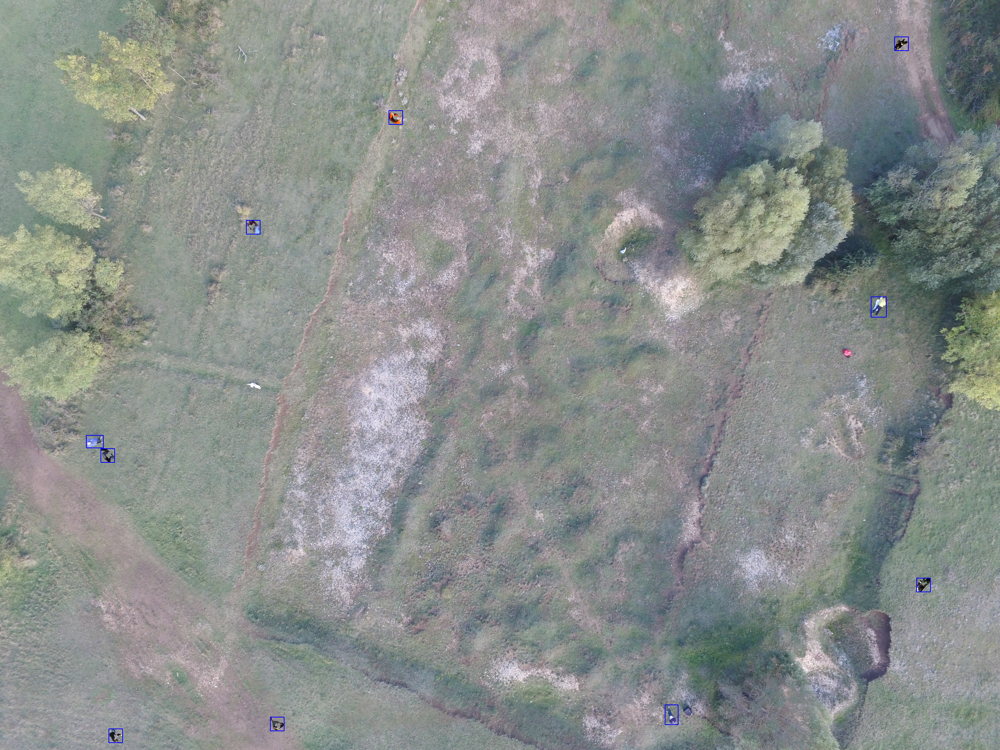

In [ ]:
cv2_imshow(l_img)